# Part 1: Color channel alignment in the spatial domain
## Part 1A: Basic alignment

In [327]:
import numpy as np
from PIL import Image
import os
import time


In [328]:
#constants
CROP_PIXELS_W = 30
CROP_PIXELS_H = 10

In [329]:
#crop images - top by CROP_PIXELS and side by CROP_PIXELS
def crop(r, g, b, CROP_PIXELS_H, CROP_PIXELS_W):
    #top image is b, then g, then r
    return r[CROP_PIXELS_H:-CROP_PIXELS_H, CROP_PIXELS_W:-CROP_PIXELS_W], g[CROP_PIXELS_H:-CROP_PIXELS_H, CROP_PIXELS_W:-CROP_PIXELS_W], b[CROP_PIXELS_H:-CROP_PIXELS_H, CROP_PIXELS_W:-CROP_PIXELS_W]


In [330]:
# load each image 
dir_path = "data/"
images = []     #color images
filenames = []
for filename in os.listdir(dir_path):
    if filename.endswith('.jpg'):
        filenames.append(filename)
        img_path = os.path.join(dir_path, filename)
        img = Image.open(img_path)
        #img.show()  # This will display the image
        

        # divide image into blue, green, and red (from top to bottom)
        #store image as float for more precision
        img = np.asarray(img).astype(float)   # note: image is now stored as rows and columns
        #Image.fromarray(img).show()
        img_height = img.shape[0] // 3
        b_boundary = img_height
        g_boundary = b_boundary + img_height
        r_boundary = g_boundary + img_height 

        b = img[0:b_boundary, :]
        g = img[b_boundary:g_boundary, :]
        r = img[g_boundary:r_boundary, :]

        #crop images and stack in color image
        color_img = np.dstack((crop(r,g,b, CROP_PIXELS_H, CROP_PIXELS_W)))
        images.append(color_img)

print(f"Loaded {len(images)} images")

Loaded 6 images


In [331]:
# standardizing data 
# See https://towardsai.net/p/data-science/how-when-and-why-should-you-normalize-standardize-rescale-your-data-3f083def38ff)
# Source for NCC: https://xcdskd.readthedocs.io/en/latest/cross_correlation/cross_correlation_coefficient.html

def standardize_data(data):
    """
    Called by cross_correlation() function
    standardize data to have mean=0 and standard_deviation=1
    """
    mean = np.mean(data)
    std = np.std(data)

    return (data - mean) / std

def ssd(arr1, arr2):
    #will clip value if overflow
    diff = arr1 - arr2
    return np.sum(diff ** 2)

In [332]:
def find_best_alignment(base_image, other_image, MAX_SHIFT_HEIGHT, MAX_SHIFT_WIDTH, SHIFT_PIXEL = 2):
    """'
    images are numpy arrays
    return height, width of the offset
    """
    lowest_ssd = ssd(base_image, other_image) #baseline 
    height_offset = 0

    best_offset_height = 0

    #search over rows first
    #shift other down
    while(height_offset < MAX_SHIFT_HEIGHT):
        height_offset += SHIFT_PIXEL
        #print(f"height_offset {height_offset}")

        # Shift the array down by SHIFT_PIXEL rows
        shifted_array = np.roll(other_image, shift=height_offset, axis=0)

        # Fill the top rows with zeros
        shifted_array[:height_offset, :] = 0

        ssd_value = ssd(base_image, shifted_array)
        if (ssd_value < lowest_ssd):
            best_offset_height = height_offset
            lowest_ssd = ssd_value


    height_offset = 0
    #shift green up
    while(height_offset > -MAX_SHIFT_HEIGHT):
        height_offset -= SHIFT_PIXEL
        #print(f"height_offset {height_offset}")

        # Shift the array up by SHIFT_PIXEL rows
        shifted_array = np.roll(other_image, shift=height_offset, axis=0)

        # Fill the bottom rows with zeros
        shifted_array[height_offset:, :] = 0

        ssd_value = ssd(base_image, shifted_array)
        #print(f"up ssd value {ssd_value}, vs best {lowest_ssd}")
        if (ssd_value < lowest_ssd):
            best_offset_height = height_offset
            lowest_ssd = ssd_value

    #search over cols
    lowest_ssd = ssd(base_image, other_image) #baseline 
    width_offset = 0
    best_offset_width = 0

    #shift green right
    while(width_offset < MAX_SHIFT_WIDTH):
        width_offset += SHIFT_PIXEL
        #print(f"width_offset {width_offset}")

        # Shift the array right by SHIFT_PIXEL rows
        shifted_array = np.roll(other_image, shift=width_offset, axis=1)

        # Fill the left cols with zeros
        shifted_array[:, :width_offset] = 0
        #print(shifted_array)

        ssd_value = ssd(base_image, shifted_array)
        # print(f"shift amount {width_offset}")
        # print(f"up ssd value {ssd_value}, vs best {lowest_ssd}")
        if (ssd_value < lowest_ssd):
            best_offset_width = width_offset
            lowest_ssd = ssd_value

    width_offset = 0
    #shift green left
    while(width_offset > -MAX_SHIFT_WIDTH):
        width_offset -= SHIFT_PIXEL
        #print(f"width_offset {width_offset}")

        # Shift the array up by SHIFT_PIXEL rows
        shifted_array = np.roll(other_image, shift=width_offset, axis=1)

        # Fill the right rows with zeros
        shifted_array[:, width_offset:] = 0
        #print(shifted_array)

        ssd_value = ssd(base_image, shifted_array)
        #print(f"up ssd value {ssd_value}, vs best {lowest_ssd}")
        if (ssd_value < lowest_ssd):
            best_offset_width = width_offset
            lowest_ssd = ssd_value

    return best_offset_height, best_offset_width
    

In [333]:
def shift_channel(channel, shift_row, shift_col):
    result = np.zeros_like(channel)
    if shift_row > 0:
        result[shift_row:, :] = channel[:-shift_row, :]
    elif shift_row < 0:
        result[:shift_row, :] = channel[-shift_row:, :]
    else:
        result = channel

    temp_result = np.zeros_like(result)
    if shift_col > 0:
        temp_result[:, shift_col:] = result[:, :-shift_col]
    elif shift_col < 0:
        temp_result[:, :shift_col] = result[:, -shift_col:]
    else:
        temp_result = result
    
    return temp_result


In [334]:
image_num  =4

blue base
Green best offset: H=12, W=-40
Red best offset:   H=6, W=0


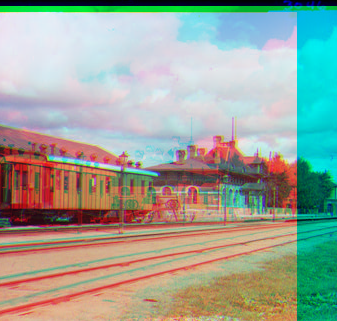

In [335]:
# search for best alignment of the color with blue

r_image = images[image_num][:,:,0]
g_image = images[image_num][:,:,1]
b_image = images[image_num][:,:,2]

#standardize each channel
r_image_stand = standardize_data(r_image)
g_image_stand = standardize_data(g_image)
b_image_stand = standardize_data(b_image)

orig_height = images[0].shape[0]
orig_width = images[0].shape[1]
MAX_SHIFT_HEIGHT = orig_height // 3
MAX_SHIFT_WIDTH = orig_width // 3

height_offset_r_bb, width_offset_r_bb = find_best_alignment(b_image_stand, r_image_stand, MAX_SHIFT_HEIGHT, MAX_SHIFT_WIDTH)
height_offset_g_bb, width_offset_g_bb = find_best_alignment(b_image_stand, g_image_stand, MAX_SHIFT_HEIGHT, MAX_SHIFT_WIDTH)

print("blue base")
print(f"Green best offset: H={height_offset_r_bb}, W={width_offset_r_bb}")
print(f"Red best offset:   H={height_offset_g_bb}, W={width_offset_g_bb}")

# Shift amounts for rows and columns

# Shift the channels
red_shifted = shift_channel(r_image, height_offset_r_bb, width_offset_r_bb)
g_shifted = shift_channel(g_image, height_offset_g_bb, width_offset_g_bb)

# recombine R,G,B image
color_img = np.dstack((red_shifted, g_shifted, b_image))
Image.fromarray(color_img.astype(np.uint8)).show()
# Image.fromarray(r_image.astype(np.uint8)).show()
# Image.fromarray(g_image.astype(np.uint8)).show()
# Image.fromarray(b_image.astype(np.uint8)).show()

green base
Green best offset: H=-6, W=-2
Red best offset:   H=6, W=2
using green base


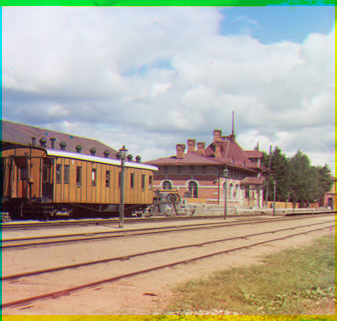

In [336]:
# search for best alignment with green


r_image = images[image_num][:,:,0]
g_image = images[image_num][:,:,1]
b_image = images[image_num][:,:,2]

#standardize each channel
r_image_stand = standardize_data(r_image)
g_image_stand = standardize_data(g_image)
b_image_stand = standardize_data(b_image)

MAX_SHIFT_HEIGHT = orig_height // 3
MAX_SHIFT_WIDTH = orig_width // 3

height_offset_r_gb, width_offset_r_gb = find_best_alignment(g_image_stand, r_image_stand, MAX_SHIFT_HEIGHT, MAX_SHIFT_WIDTH)
height_offset_b_gb, width_offset_b_gb = find_best_alignment(g_image_stand, b_image_stand, MAX_SHIFT_HEIGHT, MAX_SHIFT_WIDTH)

print("green base")
print(f"Green best offset: H={height_offset_b_gb}, W={width_offset_b_gb}")
print(f"Red best offset:   H={height_offset_r_gb}, W={width_offset_r_gb}")


# Shift amounts for rows and columns

print("using green base")
# Shift the channels
red_shifted = shift_channel(r_image, height_offset_r_gb, width_offset_r_gb)
blue_shifted = shift_channel(b_image, height_offset_b_gb, width_offset_b_gb)

# recombine R,G,B image
color_img = np.dstack((red_shifted, g_image, blue_shifted))
Image.fromarray(color_img.astype(np.uint8)).show()


red base
Green best offset: H=-12, W=0
Red best offset:   H=-6, W=-2
using red base


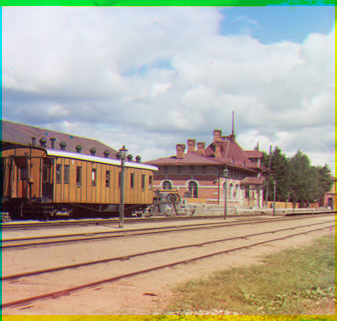

In [337]:
# search for best alignment with red


r_image = images[image_num][:,:,0]
g_image = images[image_num][:,:,1]
b_image = images[image_num][:,:,2]

#standardize each channel
r_image_stand = standardize_data(r_image)
g_image_stand = standardize_data(g_image)
b_image_stand = standardize_data(b_image)

height_offset_g_rb, width_offset_g_rb = find_best_alignment(r_image_stand, g_image_stand, MAX_SHIFT_HEIGHT, MAX_SHIFT_WIDTH)
height_offset_b_rb, width_offset_b_rb = find_best_alignment(r_image_stand, b_image_stand, MAX_SHIFT_HEIGHT, MAX_SHIFT_WIDTH)

print("red base")
print(f"Green best offset: H={height_offset_b_rb}, W={width_offset_b_rb}")
print(f"Red best offset:   H={height_offset_g_rb}, W={width_offset_g_rb}")

# Shift amounts for rows and columns

print("using red base")
# Shift the channels
red_shifted = shift_channel(r_image, height_offset_r_gb, width_offset_r_gb)
blue_shifted = shift_channel(b_image, height_offset_b_gb, width_offset_b_gb)

# recombine R,G,B image
color_img = np.dstack((red_shifted, g_image, blue_shifted))
Image.fromarray(color_img.astype(np.uint8)).show()

I found that using a green base is the best. Note: will have to convert with respect to blue.

In [338]:
def convert_to_blue_base(h_blue_gb, w__blue_gb, h_red_gb, w__red_gb):
    h_green_bb = -h_blue_gb
    w_green_bb = -w__blue_gb
    h_red_bb = h_green_bb + h_red_gb
    w_red_bb = w_green_bb + w__red_gb
    return h_red_bb, w_red_bb, h_green_bb, w_green_bb


In [339]:
filenames

['00153v.jpg',
 '00149v.jpg',
 '00351v.jpg',
 '00125v.jpg',
 '00398v.jpg',
 '01112v.jpg']

In [340]:
#Create output directory
directory_name = "part1aImages/"

#save images
if not os.path.isdir(directory_name):
    # Create the directory
    os.mkdir(directory_name)
else:
    print("Directory already exist")

00153v.jpg
Elapsed time: 284.4 milliseconds
Green base
Blue best offset:  H=-8, W=-2
Red best offset:   H=8, W=2
Blue base
Red offset:   H=16, W=4
Green offset: H=8, W=2


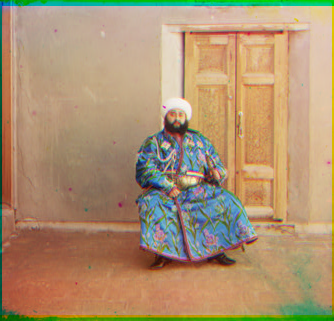

00149v.jpg
Elapsed time: 270.8 milliseconds
Green base
Blue best offset:  H=-4, W=-2
Red best offset:   H=4, W=0
Blue base
Red offset:   H=8, W=2
Green offset: H=4, W=2


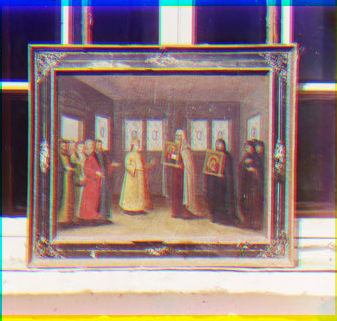

00351v.jpg
Elapsed time: 317.0 milliseconds
Green base
Blue best offset:  H=-4, W=0
Red best offset:   H=10, W=0
Blue base
Red offset:   H=14, W=0
Green offset: H=4, W=0


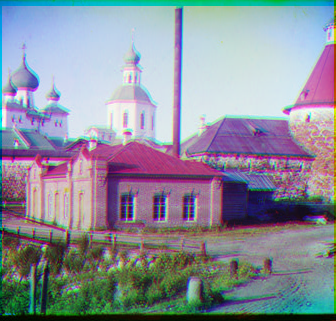

00125v.jpg
Elapsed time: 454.6 milliseconds
Green base
Blue best offset:  H=-6, W=-2
Red best offset:   H=4, W=0
Blue base
Red offset:   H=10, W=2
Green offset: H=6, W=2


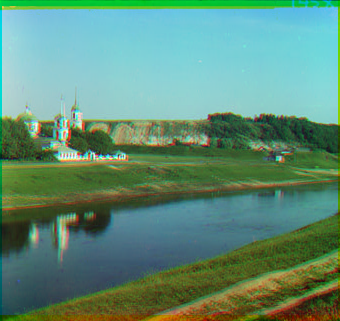

00398v.jpg
Elapsed time: 232.4 milliseconds
Green base
Blue best offset:  H=-6, W=-2
Red best offset:   H=6, W=2
Blue base
Red offset:   H=12, W=4
Green offset: H=6, W=2


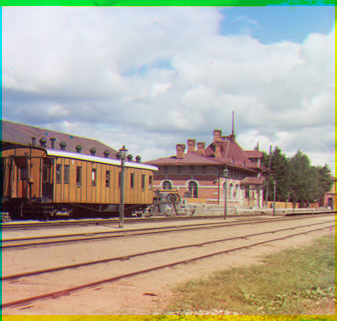

01112v.jpg
Elapsed time: 280.0 milliseconds
Green base
Blue best offset:  H=0, W=0
Red best offset:   H=6, W=2
Blue base
Red offset:   H=6, W=2
Green offset: H=0, W=0


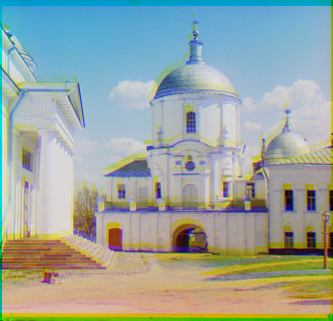

In [341]:
# search for best alignment with green
img_num = 0

orig_height = images[0].shape[0]
orig_width = images[0].shape[1]
MAX_SHIFT_HEIGHT = orig_height // 3
MAX_SHIFT_WIDTH = orig_width // 3

for image in images:
    
    r_image = image[:,:,0]
    g_image = image[:,:,1]
    b_image = image[:,:,2]
    
    #standardize each channel
    r_image_stand = standardize_data(r_image)
    g_image_stand = standardize_data(g_image)
    b_image_stand = standardize_data(b_image)

    start_time = time.time()
    
    h_red_gb, w_red_gb = find_best_alignment(g_image_stand, r_image_stand, MAX_SHIFT_HEIGHT, MAX_SHIFT_WIDTH)
    h_blue_gb, w_blue_gb = find_best_alignment(g_image_stand, b_image_stand, MAX_SHIFT_HEIGHT, MAX_SHIFT_WIDTH)

    end_time = time.time()
    print(filenames[img_num])

    elapsed_time = (end_time - start_time) * 1000
    print(f"Elapsed time: {round(elapsed_time, 1)} milliseconds")

    print("Green base")
    print(f"Blue best offset:  H={h_blue_gb}, W={w_blue_gb}")
    print(f"Red best offset:   H={h_red_gb}, W={w_red_gb}")

    print("Blue base")
    h_red_bb, w_red_bb, h_green_bb, w_green_bb = convert_to_blue_base(h_blue_gb, w_blue_gb, h_red_gb, w_red_gb)
    print(f"Red offset:   H={h_red_bb}, W={w_red_bb}")
    print(f"Green offset: H={h_green_bb}, W={w_green_bb}")
    
    # Shift amounts for rows and columns
    # Shift the channels
    red_shifted = shift_channel(r_image, height_offset_r_gb, width_offset_r_gb)
    blue_shifted = shift_channel(b_image, height_offset_b_gb, width_offset_b_gb)

    # recombine R,G,B image
    color_img = np.dstack((red_shifted, g_image, blue_shifted))
    Image.fromarray(color_img.astype(np.uint8)).show()
    color_image = Image.fromarray(color_img.astype(np.uint8))
    
    #save images
    color_image.save(directory_name + filenames[img_num], 'JPEG')

    img_num += 1

# Part 1B: Multiscale alignment

In [342]:
from PIL import Image
import numpy as np
import os
import matplotlib.pyplot as plt

In [343]:
# Function to globally normalize a 2D array to the range [0, 1] 
def normalize(data):
    return (data - data.min()) / (data.max() - data.min())

In [344]:
def pyramid_shift(image, reference, scaling, N):
    if N == 0:
        # Find displacement for image based on reference
        height_shift, width_shift = 0, 0
    else:
        # Scale the image and reference
        scaled_image = np.resize(image, (int(image.shape[0] * scaling), int(image.shape[1] * scaling)))
        scaled_reference = np.resize(reference, (int(reference.shape[0] * scaling), int(reference.shape[1] * scaling)))
        
        # Recursively call pyramid_shift
        height_shift, width_shift = pyramid_shift(scaled_image, scaled_reference, scaling, N-1)
        
        # Apply the shift to the image
        image = shift_channel(image, height_shift, width_shift)
        MAX_SHIFT_HEIGHT, MAX_SHIFT_WIDTH = 80, 80
        next_height_shift, next_width_shift = find_best_alignment(reference, image, MAX_SHIFT_HEIGHT, MAX_SHIFT_WIDTH, SHIFT_PIXEL=1)
        height_shift, width_shift = height_shift + next_height_shift, width_shift + next_width_shift
    
    return height_shift, width_shift

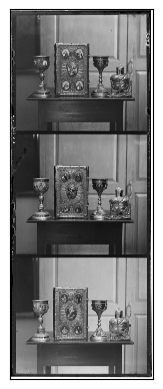

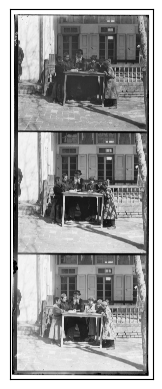

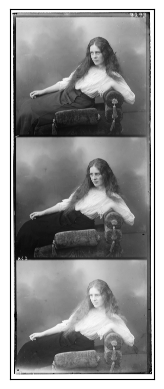

Loaded 3 images


In [347]:
# load each image 
from PIL import Image

#new way
dir_path = "data_hires/"
images_high_res = []     #color images
filenames_high = []
for filename in os.listdir(dir_path):
    if filename.endswith('.tif'):
        filenames_high.append(filename)
        img_path = os.path.join(dir_path, filename)
        img = Image.open(img_path)
        #PIL only takes certain data types https://pillow.readthedocs.io/en/stable/reference/Image.html#PIL.Image.fromarray
        #img = np.array(img).astype(float)
        img = np.array(img)

        plt.xticks([])
        plt.yticks([])
        plt.imshow(img, cmap='gray')
        plt.show()

        # divide image into blue, green, and red (from top to bottom)
        # store image as default

        img_height = img.shape[0] // 3
        b_boundary = img_height
        g_boundary = b_boundary + img_height
        r_boundary = g_boundary + img_height 

        b = img[0:b_boundary, :]
        g = img[b_boundary:g_boundary, :]
        r = img[g_boundary:r_boundary, :]

        # crop
        CROP_PIXELS_H, CROP_PIXELS_W = 550, 550
        r, g, b = crop(r, g, b, CROP_PIXELS_H, CROP_PIXELS_W)

        #crop images and stack in color image 
        color_img = np.dstack((r,g,b))
        images_high_res.append(color_img)

print(f"Loaded {len(images_high_res)} images")
        

In [348]:
#Create output directory
directory_name = "part1bImages/"

#save images
if not os.path.isdir(directory_name):
    # Create the directory
    os.mkdir(directory_name)
else:
    print("Directory already exist")

01047u.tif
Shift red (green base): H 47,W 14
Shift blue (green base): H -24,W -19
Elapsed time: 86.9 seconds
Blue base
Red offset:   H=71, W=33
Green offset: H=24, W=19


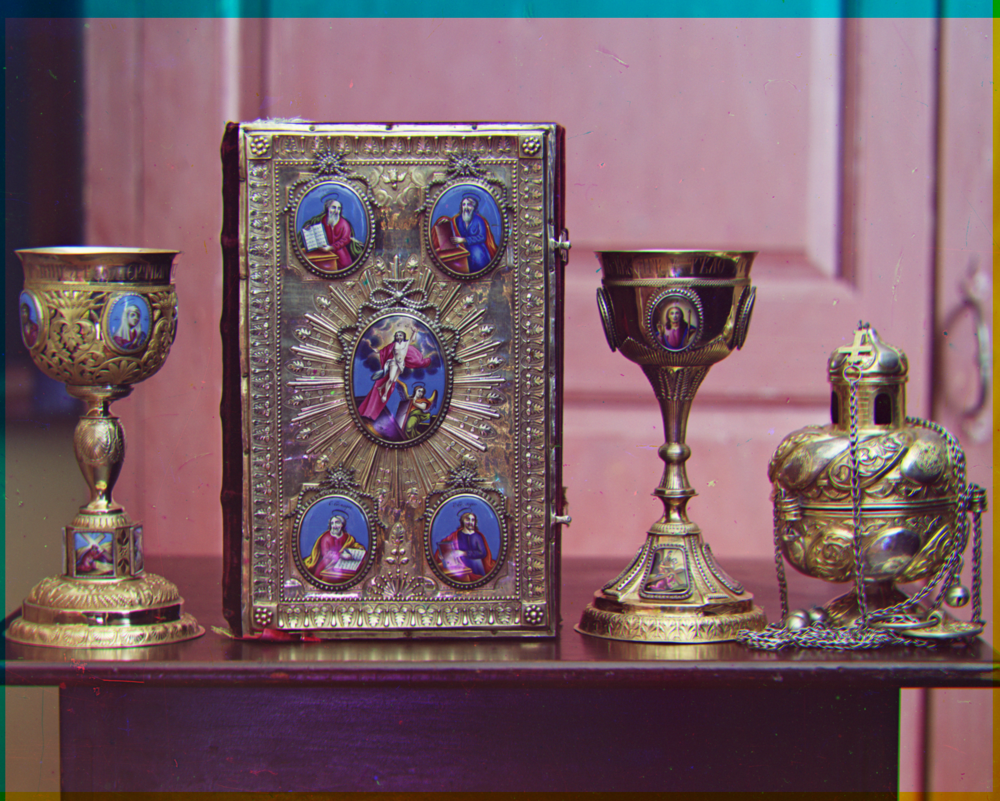

01861a.tif
Shift red (green base): H 76,W 22
Shift blue (green base): H -70,W -36
Elapsed time: 50.5 seconds
Blue base
Red offset:   H=146, W=58
Green offset: H=70, W=36


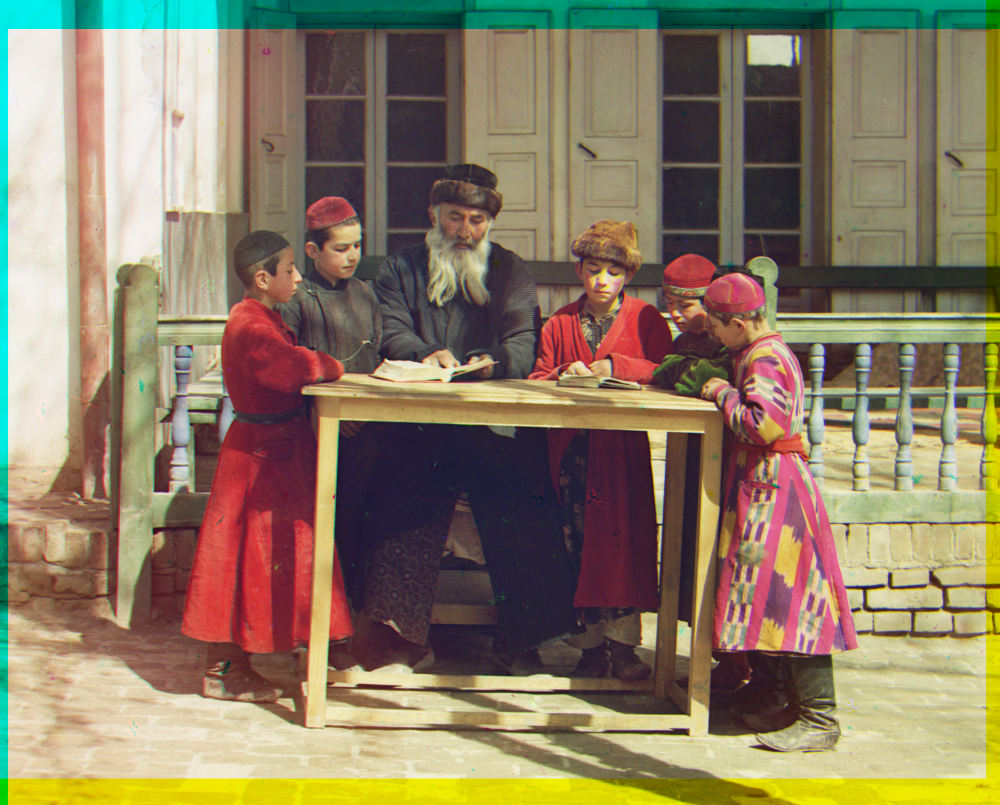

01657u.tif
Shift red (green base): H 54,W 0
Shift blue (green base): H -54,W 0
Elapsed time: 53.9 seconds
Blue base
Red offset:   H=108, W=0
Green offset: H=54, W=0


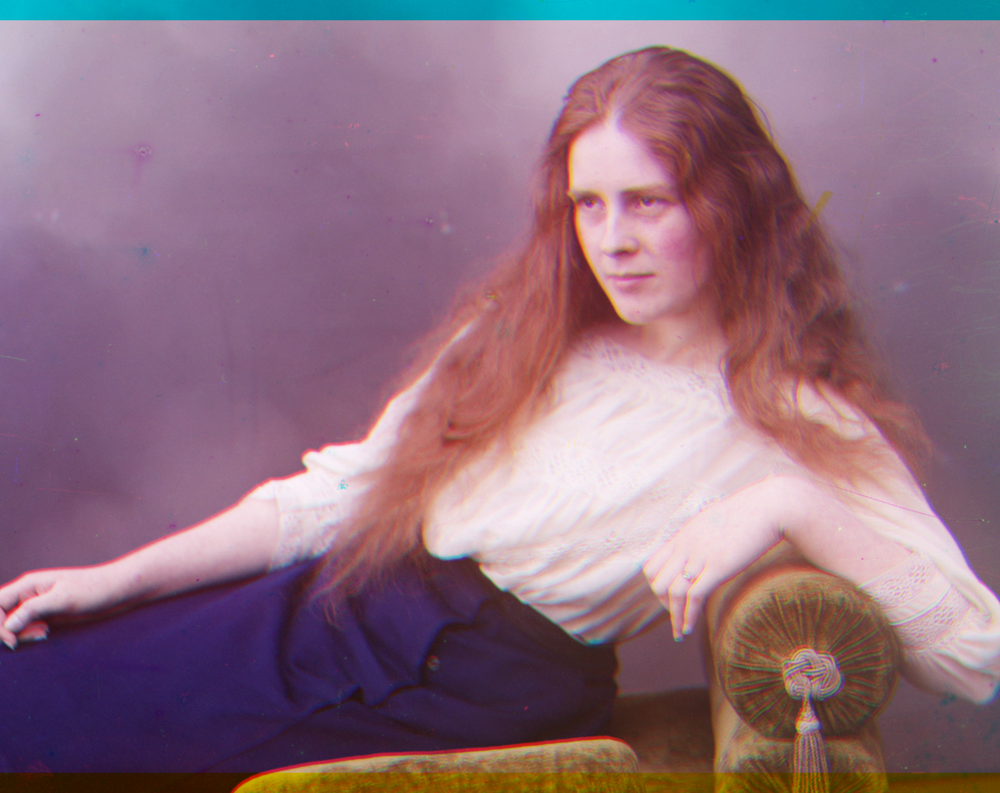

In [349]:
img_num = 0

for image in images_high_res:    
    r_image = image[:,:,0]
    g_image = image[:,:,1]
    b_image = image[:,:,2]

    # #standardize each channel
    # r_image_stand = standardize_data(r_image)
    # g_image_stand = standardize_data(g_image)
    # b_image_stand = standardize_data(b_image)

    #normal for unit16 #TODO change the name of these
    max_unit16 = 2**16 -1
    r_image_stand = max_unit16 * normalize(r_image)
    g_image_stand = max_unit16 * normalize(g_image)
    b_image_stand = max_unit16 * normalize(b_image)

    # Perform pyramid shift
    scaling = 0.5
    N = 11
    
    print(filenames_high[img_num])
    start_time = time.time()

    #compare to green
    h_red_gb, w_red_gb = pyramid_shift(r_image_stand, g_image_stand, scaling, N)
    print(f"Shift red (green base): H {h_red_gb},W {w_red_gb}")
    r_shifted = shift_channel(r_image, h_red_gb, w_red_gb)

    h_blue_gb, w_blue_gb = pyramid_shift(b_image_stand, g_image_stand, scaling, N)
    print(f"Shift blue (green base): H {h_blue_gb},W {w_blue_gb}")
    b_shifted = shift_channel(b_image, h_blue_gb, w_blue_gb)

    end_time = time.time()
    elapsed_time = (end_time - start_time)
    print(f"Elapsed time: {round(elapsed_time, 1)} seconds")

    print("Blue base")
    h_red_bb, w_red_bb, h_green_bb, w_green_bb = convert_to_blue_base(h_blue_gb, w_blue_gb, h_red_gb, w_red_gb)
    print(f"Red offset:   H={h_red_bb}, W={w_red_bb}")
    print(f"Green offset: H={h_green_bb}, W={w_green_bb}")

    color_img = np.dstack((r_shifted, g_image, b_shifted))

    # covert float to unit8
    color_img = (color_img) / max_unit16    #convert back to [0, 1] range 
    color_image_uint8 = (color_img * 255).astype(np.uint8)
    color_image_uint8 = Image.fromarray(color_image_uint8)

    #save images
    color_image_uint8.show()
    color_image_uint8.save(directory_name + filenames_high[img_num], format="TIFF")

    img_num += 1


Single scale for time check. Only check one because too long

In [350]:
def need_to_time():
    img_num = 0

    orig_height = images_high_res[0].shape[0]
    orig_width = images_high_res[0].shape[1]
    MAX_SHIFT_HEIGHT = orig_height // 3
    MAX_SHIFT_WIDTH = orig_width // 3

    image = images_high_res[0]    
    r_image = image[:,:,0]
    g_image = image[:,:,1]
    b_image = image[:,:,2]

    # #standardize each channel
    # r_image_stand = standardize_data(r_image)
    # g_image_stand = standardize_data(g_image)
    # b_image_stand = standardize_data(b_image)

    #normal for unit16 #TODO change the name of these
    max_unit16 = 2**16 -1
    r_image_stand = max_unit16 * normalize(r_image)
    g_image_stand = max_unit16 * normalize(g_image)
    b_image_stand = max_unit16 * normalize(b_image)

    # Perform pyramid shift
    scaling = 0.5
    N = 11

    print(filenames_high[img_num])
    start_time = time.time()

    #compare to blue
    h_red_bb, w_red_bb = find_best_alignment(b_image_stand, r_image_stand, MAX_SHIFT_HEIGHT, MAX_SHIFT_WIDTH)
    print(f"Shift red (green base): H {h_red_gb},W {w_red_gb}")
    r_shifted = shift_channel(r_image, h_red_gb, w_red_gb)

    h_green_bb, w_green_bb = find_best_alignment(b_image_stand, g_image_stand, MAX_SHIFT_HEIGHT, MAX_SHIFT_WIDTH)
    print(f"Shift blue (green base): H {h_green_bb},W {w_green_bb}")
    b_shifted = shift_channel(b_image, h_green_bb, w_green_bb)

    end_time = time.time()
    elapsed_time = (end_time - start_time)
    print(f"Elapsed time: {round(elapsed_time, 1)} seconds")

    # print("Blue base")
    # h_red_bb, w_red_bb, h_green_bb, w_green_bb = convert_to_blue_base(h_blue_gb, w_blue_gb, h_red_gb, w_red_gb)
    # print(f"Red offset:   H={h_red_bb}, W={w_red_bb}")
    # print(f"Green offset: H={h_green_bb}, W={w_green_bb}")

    color_img = np.dstack((r_shifted, g_image, b_shifted))

    # covert float to unit8
    color_img = (color_img) / max_unit16    #convert back to [0, 1] range 
    color_image_uint8 = (color_img * 255).astype(np.uint8)
    color_image_uint8 = Image.fromarray(color_image_uint8)

    #save images
    color_image_uint8.show()
    color_image_uint8.save(directory_name + filenames[img_num], format="TIFF")

    img_num += 1

In [351]:
need_to_time = False
if(need_to_time):
    need_to_time()

#else don't call it because it take too long